# "Finding correlation in weather data using pandas"
> "A quick glance on how to use pandas"
- toc:true
- branch:master
- badges:true
- comments:true
- author: fastdaima
- categories: [pandas]



# import libraries


In [2]:

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr

%matplotlib inline

C:\Users\91790\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# load hourly data


In [3]:
#collapse-hide
data = pd.read_csv('https://raw.githubusercontent.com/PacktWorkshops/The-Data-Analysis-Workshop/master/Chapter01/data/hour.csv')

In [4]:
data.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


# create new column by encoding the weathersit one

In [5]:

#collapse-show
weather_mapping = {1: 'clear', 2: 'cloudy', \
                   3: 'light_rain_snow', 4: 'heavy_rain_snow'}
data['weather'] = data['weathersit']\
    .apply(lambda x: weather_mapping[x])

# define a function for creating a regression plot for a specified weather condition


In [6]:
def create_regression_plot(data, col, weather_cond):
    # extract data for the specific weather condition
    plot_data = data[data['weather'] == weather_cond]

    # create regplot for registered users
    ax = sns.regplot(x=col, y="registered", data=plot_data, \
                     scatter_kws={"alpha":0.05})
    
    # create regplot for casual users
    ax = sns.regplot(x=col, y="casual", data=plot_data, \
                     scatter_kws={"alpha":0.05})
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_title(f"{col} | {weather_cond}")
    return ax

In [7]:
# create 4 by 4 regplots with columns and weather conditions


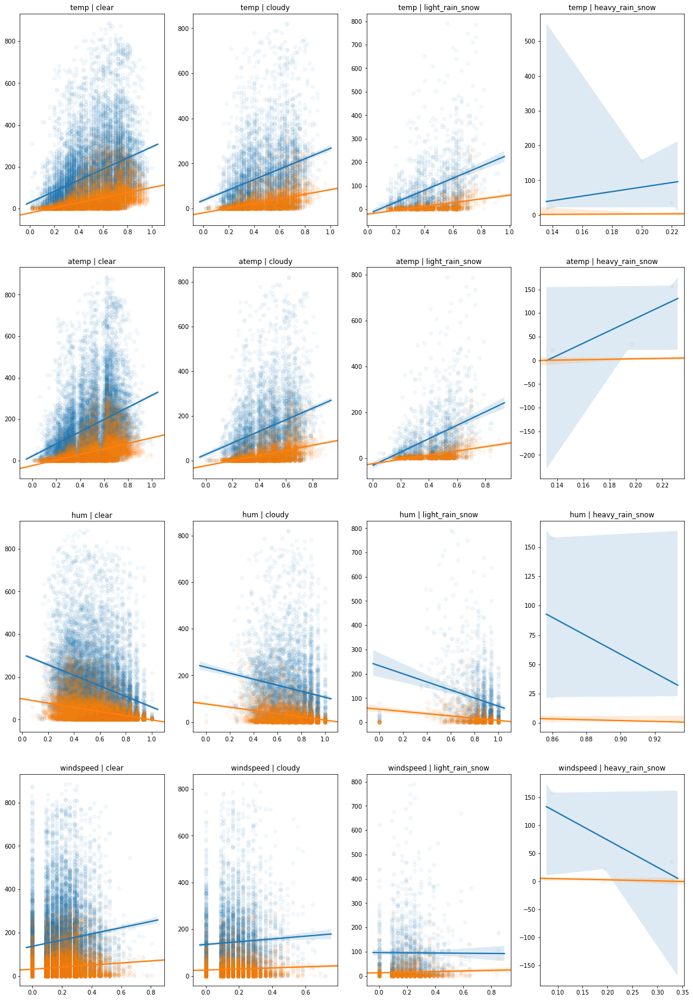

In [8]:
weather_conditions = data.weather.unique()
columns = ["temp", "atemp", "hum", "windspeed"]

plt.figure(figsize=(20,30))
for col_index, col in enumerate(columns):
    for row_index, weather_cond in enumerate(weather_conditions):
        plot_number = row_index + col_index*4 + 1
        plt.subplot(4,4,plot_number)
        create_regression_plot(data, col, weather_cond)

# create function for computing pearson correlation


In [9]:
def print_correlations(data, col, weather_cond):
    # extract data for the specific weather condition
    corr_data = data[data['weather'] == weather_cond]
    
    # compute pearson correlation between col and registered rides
    pearson_corr_r = pearsonr(corr_data[col], corr_data["registered"])
    
    # compute pearson correlation between col and registered rides
    pearson_corr_c = pearsonr(corr_data[col], corr_data["casual"])
    
    # print correlations
    print(f"Pearson correlation (registered, {col}): corr={pearson_corr_r[0]:.03f}, pval={pearson_corr_r[1]:.03f}")
    print(f"Pearson correlation (casual, {col}): corr={pearson_corr_c[0]:.03f}, pval={pearson_corr_c[1]:.03f}")


# print correlations for temp, atemp, hum and windspeed columns with registered and casual rides

In [10]:
weather_conditions = data.weather.unique()
columns = ["temp", "atemp", "hum", "windspeed"]

for col in columns:
    for weather_cond in weather_conditions:
        print_correlations(data, col, weather_cond)

Pearson correlation (registered, temp): corr=0.340, pval=0.000
Pearson correlation (casual, temp): corr=0.459, pval=0.000
Pearson correlation (registered, temp): corr=0.285, pval=0.000
Pearson correlation (casual, temp): corr=0.437, pval=0.000
Pearson correlation (registered, temp): corr=0.356, pval=0.000
Pearson correlation (casual, temp): corr=0.433, pval=0.000
Pearson correlation (registered, temp): corr=0.360, pval=0.766
Pearson correlation (casual, temp): corr=0.277, pval=0.821
Pearson correlation (registered, atemp): corr=0.334, pval=0.000
Pearson correlation (casual, atemp): corr=0.451, pval=0.000
Pearson correlation (registered, atemp): corr=0.285, pval=0.000
Pearson correlation (casual, atemp): corr=0.434, pval=0.000
Pearson correlation (registered, atemp): corr=0.366, pval=0.000
Pearson correlation (casual, atemp): corr=0.445, pval=0.000
Pearson correlation (registered, atemp): corr=0.810, pval=0.399
Pearson correlation (casual, atemp): corr=0.756, pval=0.454
Pearson correlat